<a href="https://colab.research.google.com/github/hmyrcmn/FaceMaskDetectionYolo/blob/h%C4%B1jyen/ourTestDataFacebokHumandetli.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install transformers torchvision pillow
!pip install icrawler

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 37.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 29.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 34.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 16.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 90.9 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitlin

In [2]:
from transformers import DetrImageProcessor, DetrForObjectDetection
import torch
from PIL import Image
import requests
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import os


In [3]:
processor = DetrImageProcessor.from_pretrained("facebook/detr-resnet-50")
model = DetrForObjectDetection.from_pretrained("facebook/detr-resnet-50")


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/290 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.59k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/102M [00:00<?, ?B/s]

/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:2397: UserWarning: for conv1.weight: copying from a non-meta parameter in the checkpoint to a meta parameter in the current model, which is a no-op. (Did you mean to pass `assign=True` to assign items in the state dictionary to their corresponding key in the module instead of copying them in place?)
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:2397: UserWarning: for bn1.weight: copying from a non-meta parameter in the checkpoint to a meta parameter in the current model, which is a no-op. (Did you mean to pass `assign=True` to assign items in the state dictionary to their corresponding key in the module instead of copying them in place?)
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:2397: UserWarning: for bn1.bias: copying from a non-meta parameter in the checkpoint to a meta parameter in the current model, which is a no-op. (Did you mean to pas

In [4]:
import zipfile
import os

zip_path = "/content/test-20250507T054648Z-001.zip"  # .zip dosyasının yolu
extract_to = "/content/testData"     # Çıkartılacak klasör

# Hedef klasör yoksa oluştur
os.makedirs(extract_to, exist_ok=True)

# Zip dosyasını aç ve çıkart
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to)

print("Zip dosyası başarıyla çıkartıldı.")


Zip dosyası başarıyla çıkartıldı.


In [9]:
import zipfile
import os

zip_path = "/content/test-LABEL.zip"  # .zip dosyasının yolu
extract_to = "/content/testDataLabel"     # Çıkartılacak klasör

# Hedef klasör yoksa oluştur
os.makedirs(extract_to, exist_ok=True)

# Zip dosyasını aç ve çıkart
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to)

print("Zip dosyası başarıyla çıkartıldı.")


Zip dosyası başarıyla çıkartıldı.


In [5]:
from PIL import Image
import os


# Giriş ve çıkış klasörleri
input_folder = "/content/testData/test"
output_folder = "/content/Mask-boneHumanDetected"
os.makedirs(output_folder, exist_ok=True)

# Resim dosyalarını al
image_files = [f for f in os.listdir(input_folder) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

# Her resim için işle
for img_name in image_files:
    image_path = os.path.join(input_folder, img_name)
    image = Image.open(image_path).convert("RGB")

    # Model tahmini
    inputs = processor(images=image, return_tensors="pt")
    outputs = model(**inputs)
    target_sizes = torch.tensor([image.size[::-1]])
    results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=0.9)[0]

    # Her nesneyi kontrol et
    for i, (score, label, box) in enumerate(zip(results["scores"], results["labels"], results["boxes"])):
        label_name = model.config.id2label[label.item()]

        if label_name.lower() == "person":  # sadece insan
            box = [int(i) for i in box.tolist()]
            x_min, y_min, x_max, y_max = box

            # Görüntü boyutları dışına taşmasın
            x_min = max(0, x_min)
            y_min = max(0, y_min)
            x_max = min(image.width, x_max)
            y_max = min(image.height, y_max)

            cropped = image.crop((x_min, y_min, x_max, y_max))

            # Çıkış dosya adı ve format
            file_root, file_ext = os.path.splitext(img_name)  # .jpg, .jpeg, .png gibi uzantıları ayır
            output_name = f"{file_root}_person{i+1}{file_ext}"  # Aynı formatta kaydet

            # Kaydet
            cropped.save(os.path.join(output_folder, output_name))

print("✅ Sadece 'person' (insan) nesneleri kırpıldı ve çıkış klasörüne kaydedildi.")


✅ Sadece 'person' (insan) nesneleri kırpıldı ve çıkış klasörüne kaydedildi.


In [6]:
!pip install ultralytics


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 56.4 MB/s eta 0:00:00


In [7]:
from ultralytics import YOLO
import os

# Modeli yükle (örneğin: 'best.pt')
model_path = "/content/best.pt"  # kendi model ağırlığını buraya koy
model = YOLO(model_path)

# Girdi klasörü (yüz kırpılmış resimler)
input_dir = "/content/Mask-boneHumanDetected"
output_dir = "/content/Mask-boneHumanDetected/yolo_outputsHUMAN"
os.makedirs(output_dir, exist_ok=True)

# Tüm yüz kırpıntılarına inference yap
results = model.predict(
    source=input_dir,        # klasördeki resimler
    conf=0.25,               # güven eşiği
    save=True,               # tahminleri kaydet
    save_txt=True,           # .txt formatında bbox bilgileri
    project=output_dir,      # çıktı klasörü
    name="predictions",      # alt klasör adı
    exist_ok=True            # üzerine yazabilsin
)


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.

image 1/231 /content/Mask-boneHumanDetected/image_103_jpg.rf.9da44bf113ce1e0f007d255819b8bc73_person1.jpg: 640x448 1 bone, 61.4ms
image 2/231 /content/Mask-boneHumanDetected/image_103_jpg.rf.9da44bf113ce1e0f007d255819b8bc73_person3.jpg: 640x416 1 bone, 39.1ms
image 3/231 /content/Mask-boneHumanDetected/image_103_jpg.rf.9da44bf113ce1e0f007d255819b8bc73_person4.jpg: 640x416 1 bone, 1 mask, 7.7ms
image 4/231 /content/Mask-boneHumanDetected/image_108_jpg.rf.a2f7abd1903cad6889d5c8db388c201e_person3.jpg: 640x352 (no detections), 38.0ms
image 5/231 /content/Mask-boneHumanDetected/image_108_jpg.rf.a2f7abd1903cad6889d5c8db388c201e_person4.jpg: 640x416 1 bone, 2 nomasks, 7.3ms
image 6/231 

# gerçek etiketle karşılatşırma

In [ ]:
import os
import numpy as np
from sklearn.metrics import confusion_matrix, classification_report, ConfusionMatrixDisplay
import matplotlib.pyplot as plt


In [10]:
import os
from collections import defaultdict

# Giriş dosyalarının bulunduğu klasör
input_folder = '/content/Mask-boneHumanDetected/yolo_outputsHUMAN/predictions/labels'

# Birleştirilmiş dosyaların kaydedileceği yeni klasör
output_folder = '/content/Mask-boneHumanDetected/yolo_outputsHUMAN/predictions/labels2'

# Çıkış klasörünü oluştur (eğer yoksa)
os.makedirs(output_folder, exist_ok=True)

# Gruplamak için bir sözlük
file_groups = defaultdict(list)

# Klasördeki tüm .txt dosyalarını oku
for filename in os.listdir(input_folder):
    if filename.endswith('.txt'):
        # Dosya adından 'personX' kısmını çıkar
        if '_person' in filename:
            base_name = filename.split('_person')[0]  # Ana ismi al
            file_groups[base_name].append(filename)

# Her grup için dosyaları birleştir ve yeni klasöre yaz
for base_name, files in file_groups.items():
    output_file_path = os.path.join(output_folder, f"{base_name}.txt")

    with open(output_file_path, 'w') as outfile:
        for fname in files:
            file_path = os.path.join(input_folder, fname)
            with open(file_path, 'r') as infile:
                content = infile.read()
                outfile.write(content)

    print(f"{output_file_path} oluşturuldu.")

print("Tüm dosyalar başarıyla birleştirildi ve yeni klasöre kaydedildi.")

/content/Mask-boneHumanDetected/yolo_outputsHUMAN/predictions/labels2/image_269_jpg.rf.5d8cb36cf83bb205c2e4fbf129bc4a2f.txt oluşturuldu.
/content/Mask-boneHumanDetected/yolo_outputsHUMAN/predictions/labels2/image_193_jpg.rf.c39fc1a014c2dceed7668901332ab510.txt oluşturuldu.
/content/Mask-boneHumanDetected/yolo_outputsHUMAN/predictions/labels2/image_368_jpg.rf.7f84e6da8765b7c3c63fbade21ec4489.txt oluşturuldu.
/content/Mask-boneHumanDetected/yolo_outputsHUMAN/predictions/labels2/image_34_jpg.rf.5582c8a6a010043da9402c3c5c0a0d35.txt oluşturuldu.
/content/Mask-boneHumanDetected/yolo_outputsHUMAN/predictions/labels2/image_169_jpg.rf.be7d94b64aed531f8b66aa816d1bf472.txt oluşturuldu.
/content/Mask-boneHumanDetected/yolo_outputsHUMAN/predictions/labels2/image_324_jpg.rf.85bdb7fe802d40837f7600b73e5e2ec4.txt oluşturuldu.
/content/Mask-boneHumanDetected/yolo_outputsHUMAN/predictions/labels2/image_304_jpg.rf.afb065762204ff961e5bbe1a95b90a83.txt oluşturuldu.
/content/Mask-boneHumanDetected/yolo_outpu

In [12]:
import os

# Klasör yolları
folder1 = '/content/Mask-boneHumanDetected/yolo_outputsHUMAN/predictions/labels2'
folder2 = '/content/testDataLabel/test'

# Dosya isimlerini al (uzantı olmadan)
def get_filenames_without_ext(folder):
    return {os.path.splitext(f)[0] for f in os.listdir(folder) if os.path.isfile(os.path.join(folder, f))}

# Dosya isimlerini al
files1 = get_filenames_without_ext(folder1)
files2 = get_filenames_without_ext(folder2)

# Ortak olanlar (aynı isimle iki klasörde de var)
common = files1 & files2

# Birinde olup diğerinde olmayanlar
only_in_folder1 = files1 - files2
only_in_folder2 = files2 - files1

# Sonuçları yazdır
print(f"Toplam dosya sayısı:")
print(f"- Klasör 1: {len(files1)}")
print(f"- Klasör 2: {len(files2)}")
print()
print(f"Ortak dosya sayısı (aynı isimle): {len(common)}")
print(f"Farklı isimli dosya sayısı (sadece birinde olan): {len(only_in_folder1) + len(only_in_folder2)}")
print()
print(f"Ayrıntılı:")
print(f"- Sadece Klasör 1'de olan: {len(only_in_folder1)} adet")
print(f"- Sadece Klasör 2'de olan: {len(only_in_folder2)} adet")

Toplam dosya sayısı:
- Klasör 1: 77
- Klasör 2: 123

Ortak dosya sayısı (aynı isimle): 77
Farklı isimli dosya sayısı (sadece birinde olan): 46

Ayrıntılı:
- Sadece Klasör 1'de olan: 0 adet
- Sadece Klasör 2'de olan: 46 adet


Confusion Matrix:
[[41 12 10  2]
 [13 16  0  7]
 [ 9  3 30 25]
 [ 5  5 26 31]]

Classification Report:
              precision    recall  f1-score   support

           0       0.60      0.63      0.62        65
           1       0.44      0.44      0.44        36
           2       0.45      0.45      0.45        67
           3       0.48      0.46      0.47        67

    accuracy                           0.50       235
   macro avg       0.49      0.50      0.50       235
weighted avg       0.50      0.50      0.50       235



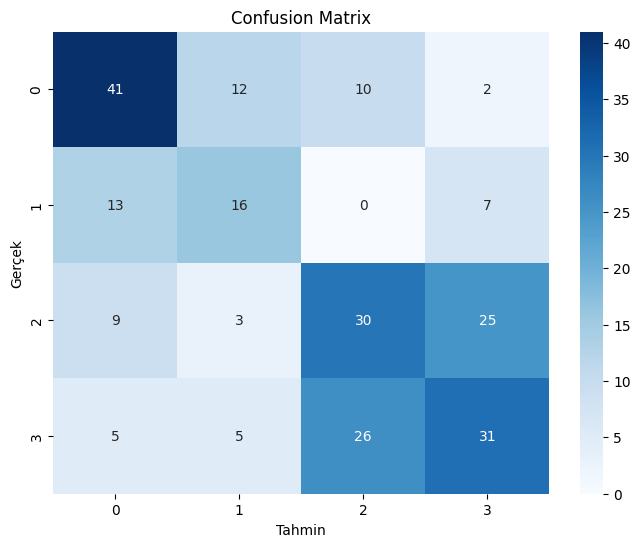

In [14]:
folder_true =  '/content/testDataLabel/test' # Gerçek etiketler (.txt)
folder_pred = '/content/Mask-boneHumanDetected/yolo_outputsHUMAN/predictions/labels2'  # Tahmin edilen etiketler (.txt)

import seaborn as sns
# Ortak dosyaları bul (sadece aynı isimde olanlar)
def get_common_files(folder1, folder2):
    files1 = {f for f in os.listdir(folder1) if f.endswith('.txt')}
    files2 = {f for f in os.listdir(folder2) if f.endswith('.txt')}

    common_files = set()
    for f in files1:
        if f in files2:
            common_files.add(f)
    return sorted(common_files)

# Sadece sınıf ID'lerini oku
def read_class_ids(file_path):
    class_ids = []
    with open(file_path, 'r') as f:
        for line in f:
            parts = line.strip().split()
            if parts:
                class_ids.append(int(parts[0]))
    return class_ids

# Ortak dosyaları al
common_files = get_common_files(folder_true, folder_pred)

# Gerçek ve tahmin listeleri
y_true = []
y_pred = []

for fname in common_files:
    true_path = os.path.join(folder_true, fname)
    pred_path = os.path.join(folder_pred, fname)

    true_ids = read_class_ids(true_path)
    pred_ids = read_class_ids(pred_path)

    # Uzunluk eşitleme (eğer birinde birden fazla nesne varsa dikkat!)
    min_len = min(len(true_ids), len(pred_ids))
    y_true.extend(true_ids[:min_len])
    y_pred.extend(pred_ids[:min_len])

# Confusion Matrix
cm = confusion_matrix(y_true, y_pred)
print("Confusion Matrix:")
print(cm)

# Sınıfların listesi
classes = sorted(set(y_true + y_pred))

# Classification Report
print("\nClassification Report:")
print(classification_report(y_true, y_pred, labels=classes))

# Görselleştirme
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=classes, yticklabels=classes)
plt.xlabel('Tahmin')
plt.ylabel('Gerçek')
plt.title('Confusion Matrix')
plt.show()

# normal test

In [8]:
from ultralytics import YOLO
import os

# Modeli yükle (örneğin: 'best.pt')
model_path = "/content/best.pt"  # kendi model ağırlığını buraya koy
model = YOLO(model_path)

# Girdi klasörü (yüz kırpılmış resimler)
input_dir = "/content/testData/test"
output_dir = "/content/Mask-boneHumanDetected/yolo_outputs"
os.makedirs(output_dir, exist_ok=True)

# Tüm yüz kırpıntılarına inference yap
results = model.predict(
    source=input_dir,        # klasördeki resimler
    conf=0.25,               # güven eşiği
    save=True,               # tahminleri kaydet
    save_txt=True,           # .txt formatında bbox bilgileri
    project=output_dir,      # çıktı klasörü
    name="predictions",      # alt klasör adı
    exist_ok=True            # üzerine yazabilsin
)



image 1/119 /content/testData/test/image_103_jpg.rf.9da44bf113ce1e0f007d255819b8bc73.jpg: 640x640 2 bones, 2 masks, 57.4ms
image 2/119 /content/testData/test/image_108_jpg.rf.a2f7abd1903cad6889d5c8db388c201e.jpg: 640x640 1 bone, 2 nomasks, 40.7ms
image 3/119 /content/testData/test/image_112_jpg.rf.f86c89a61d358a11a0d3f060053bab30.jpg: 640x640 1 bone, 1 mask, 14.1ms
image 4/119 /content/testData/test/image_117_jpg.rf.2f803ed58dcebdb19aed6408d251e81f.jpg: 640x640 1 bone, 17.7ms
image 5/119 /content/testData/test/image_117_jpg.rf.8034df50573228950a9b4be9cc52b039.jpg: 640x640 1 nomask, 45.0ms
image 6/119 /content/testData/test/image_121_jpg.rf.68c40f1500d02dc530a514ac9d1e3626.jpg: 640x640 1 bone, 1 mask, 39.0ms
image 7/119 /content/testData/test/image_122_jpg.rf.fdc2b395729d2a3d6c4ff466dabbda60.jpg: 640x640 3 bones, 4 nomasks, 1 mask, 23.9ms
image 8/119 /content/testData/test/image_124_jpg.rf.6e4a3da1fcccd369ef949d3ad7281533.jpg: 640x640 3 bones, 4 masks, 8.8ms
image 9/119 /content/testDa

In [16]:
import os

# Klasör yolları
folder1 = '/content/Mask-boneHumanDetected/yolo_outputs/predictions/labels'
folder2 = '/content/testDataLabel/test'

# Dosya isimlerini al (uzantı olmadan)
def get_filenames_without_ext(folder):
    return {os.path.splitext(f)[0] for f in os.listdir(folder) if os.path.isfile(os.path.join(folder, f))}

# Dosya isimlerini al
files1 = get_filenames_without_ext(folder1)
files2 = get_filenames_without_ext(folder2)

# Ortak olanlar (aynı isimle iki klasörde de var)
common = files1 & files2

# Birinde olup diğerinde olmayanlar
only_in_folder1 = files1 - files2
only_in_folder2 = files2 - files1

# Sonuçları yazdır
print(f"Toplam dosya sayısı:")
print(f"- Klasör 1: {len(files1)}")
print(f"- Klasör 2: {len(files2)}")
print()
print(f"Ortak dosya sayısı (aynı isimle): {len(common)}")
print(f"Farklı isimli dosya sayısı (sadece birinde olan): {len(only_in_folder1) + len(only_in_folder2)}")
print()
print(f"Ayrıntılı:")
print(f"- Sadece Klasör 1'de olan: {len(only_in_folder1)} adet")
print(f"- Sadece Klasör 2'de olan: {len(only_in_folder2)} adet")

Toplam dosya sayısı:
- Klasör 1: 111
- Klasör 2: 123

Ortak dosya sayısı (aynı isimle): 111
Farklı isimli dosya sayısı (sadece birinde olan): 12

Ayrıntılı:
- Sadece Klasör 1'de olan: 0 adet
- Sadece Klasör 2'de olan: 12 adet


Confusion Matrix:
[[54 28 18  4]
 [19 25  2  7]
 [18  5 51 14]
 [ 0  3 28 42]]

Classification Report:
              precision    recall  f1-score   support

           0       0.59      0.52      0.55       104
           1       0.41      0.47      0.44        53
           2       0.52      0.58      0.55        88
           3       0.63      0.58      0.60        73

    accuracy                           0.54       318
   macro avg       0.54      0.54      0.53       318
weighted avg       0.55      0.54      0.54       318



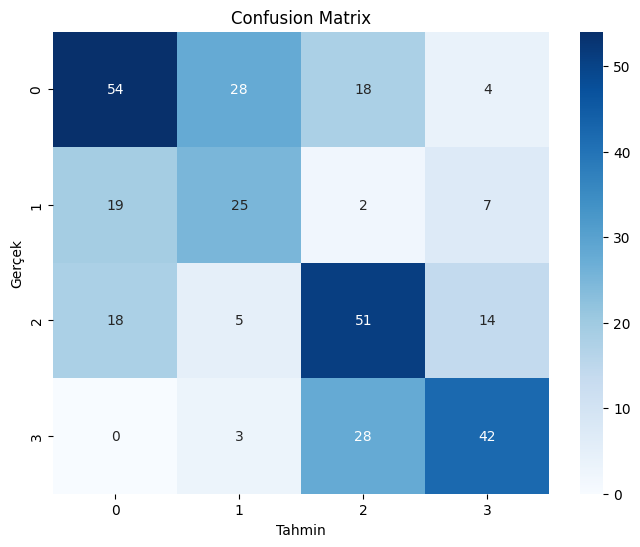

In [15]:
folder_true =  '/content/testDataLabel/test' # Gerçek etiketler (.txt)
folder_pred = '/content/Mask-boneHumanDetected/yolo_outputs/predictions/labels'  # Tahmin edilen etiketler (.txt)

import seaborn as sns
# Ortak dosyaları bul (sadece aynı isimde olanlar)
def get_common_files(folder1, folder2):
    files1 = {f for f in os.listdir(folder1) if f.endswith('.txt')}
    files2 = {f for f in os.listdir(folder2) if f.endswith('.txt')}

    common_files = set()
    for f in files1:
        if f in files2:
            common_files.add(f)
    return sorted(common_files)

# Sadece sınıf ID'lerini oku
def read_class_ids(file_path):
    class_ids = []
    with open(file_path, 'r') as f:
        for line in f:
            parts = line.strip().split()
            if parts:
                class_ids.append(int(parts[0]))
    return class_ids

# Ortak dosyaları al
common_files = get_common_files(folder_true, folder_pred)

# Gerçek ve tahmin listeleri
y_true = []
y_pred = []

for fname in common_files:
    true_path = os.path.join(folder_true, fname)
    pred_path = os.path.join(folder_pred, fname)

    true_ids = read_class_ids(true_path)
    pred_ids = read_class_ids(pred_path)

    # Uzunluk eşitleme (eğer birinde birden fazla nesne varsa dikkat!)
    min_len = min(len(true_ids), len(pred_ids))
    y_true.extend(true_ids[:min_len])
    y_pred.extend(pred_ids[:min_len])

# Confusion Matrix
cm = confusion_matrix(y_true, y_pred)
print("Confusion Matrix:")
print(cm)

# Sınıfların listesi
classes = sorted(set(y_true + y_pred))

# Classification Report
print("\nClassification Report:")
print(classification_report(y_true, y_pred, labels=classes))

# Görselleştirme
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=classes, yticklabels=classes)
plt.xlabel('Tahmin')
plt.ylabel('Gerçek')
plt.title('Confusion Matrix')
plt.show()

# 2 mdoelin birbiriyle uyumuna bakalım

In [17]:
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score
from glob import glob

# Ground truth (etiklenen veriler) ve tahmin verilerini yükleyelim
def load_yolo_labels(label_folder):
    labels = {}
    for label_file in glob(os.path.join(label_folder, "*.txt")):
        filename = os.path.basename(label_file).split(".")[0]  # Dosya ismini al
        with open(label_file, "r") as f:
            labels[filename] = [line.strip().split() for line in f.readlines()]  # her satırı al
    return labels

# Ground truth ve tahmin verilerini yükle
ground_truth_folder = "/content/Mask-boneHumanDetected/yolo_outputs/predictions/labels" # humanles
predictions_folder = "/content/Mask-boneHumanDetected/yolo_outputsHUMAN/predictions/labels2" # human


Filename,Model 1 Predictions,Model 2 Prediction
image_103_jpg.rf.9da44bf113ce1e0f007d255819b8bc73.jpg,| |,
image_108_jpg.rf.a2f7abd1903cad6889d5c8db388c201e.jpg,|,
image_112_jpg.rf.f86c89a61d358a11a0d3f060053bab30.jpg,| |,
image_117_jpg.rf.8034df50573228950a9b4be9cc52b039.jpg,,
image_121_jpg.rf.68c40f1500d02dc530a514ac9d1e3626.jpg,| | | | |,
image_122_jpg.rf.fdc2b395729d2a3d6c4ff466dabbda60.jpg,| | | |,
image_124_jpg.rf.6e4a3da1fcccd369ef949d3ad7281533.jpg,,
image_129_jpg.rf.f7bdc1a1e88d5becbed8600de2278c5f.jpg,,
image_12_jpg.rf.82a1f6473b0a4b392619b9dd0cbbaceb.jpg,| | | |,
image_12_jpg.rf.c10fc5f5531f9b1cb212a8e7baf876c8.jpg,| | |,

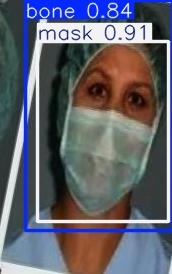
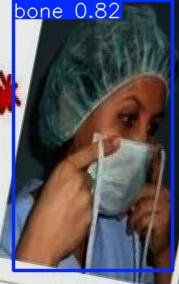
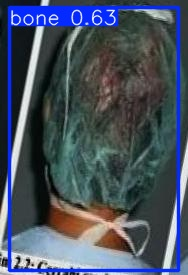
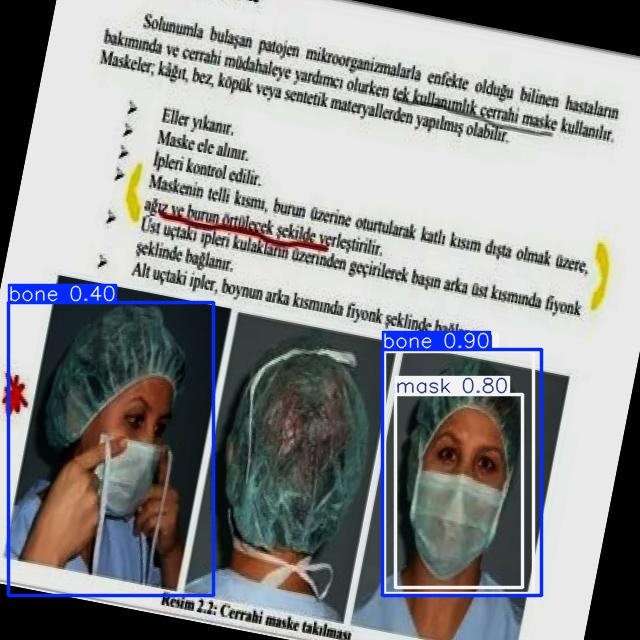
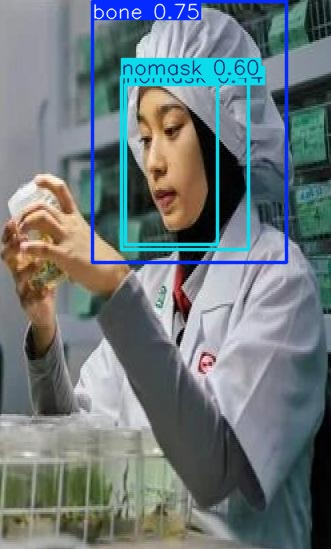
...
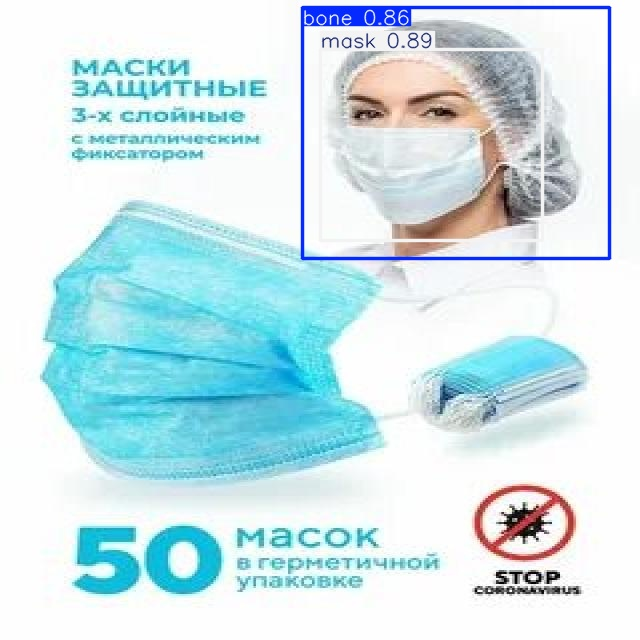
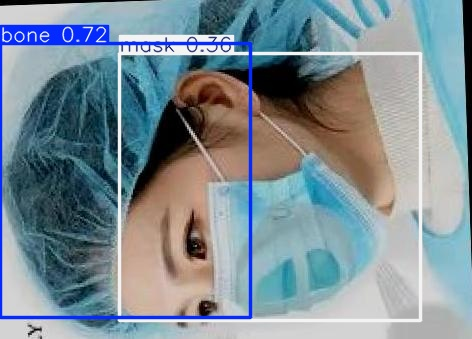
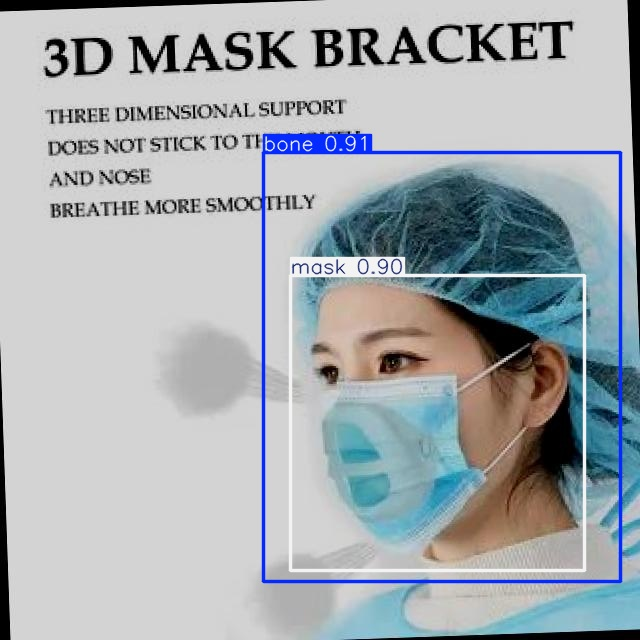
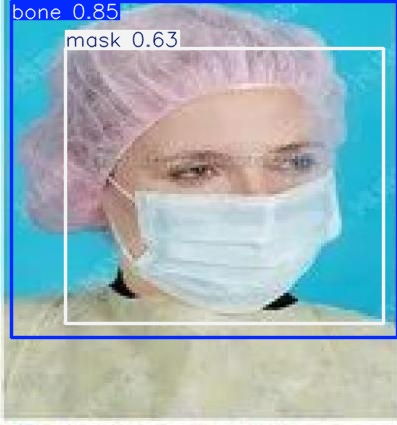
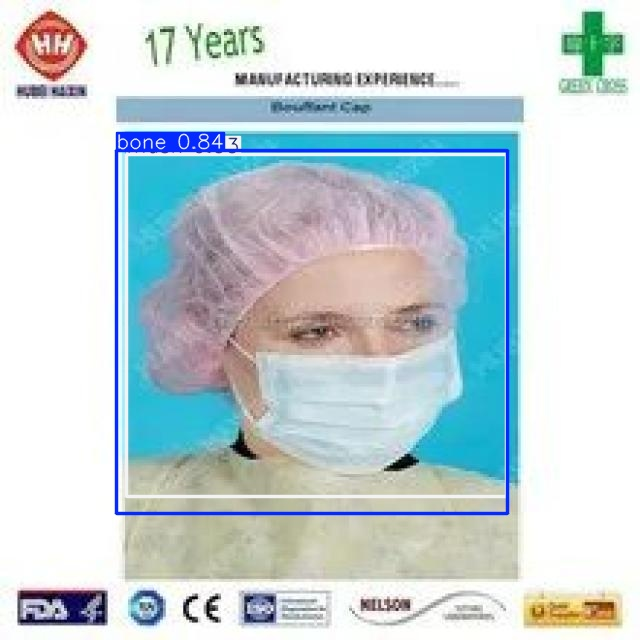

In [18]:
import os
import base64
from IPython.display import display, HTML

# === Dizinler ===
model1_images_path = "/content/Mask-boneHumanDetected/yolo_outputsHUMAN/predictions" # human"
model2_images_path = '/content/Mask-boneHumanDetected/yolo_outputs/predictions'

def image_to_base64_html(image_path):
    """Resmi base64 formatında HTML img tagine dönüştür"""
    if not os.path.exists(image_path):
        return "N/A"
    with open(image_path, "rb") as img_file:
        b64 = base64.b64encode(img_file.read()).decode('utf-8')
        return f'<img src="data:image/jpeg;base64,{b64}" />'

def strip_person_suffix(filename):
    """Resim adından '_personx' gibi son ekleri sil ve sadece temel dosya adı al"""
    base, ext = os.path.splitext(filename)
    base = base.split('_person')[0]  # person'ı ayırıyoruz
    return base + ext  # orijinal formatı koruyoruz

# === Ortak dosya adı ve uzantılarına sahip dosyaları bul ===
model1_files = [f for f in os.listdir(model1_images_path) if os.path.splitext(f)[1].lower() in ('.jpg', '.jpeg', '.png', '.bmp', '.gif', '.tiff')]
model2_files = [f for f in os.listdir(model2_images_path) if os.path.splitext(f)[1].lower() in ('.jpg', '.jpeg', '.png', '.bmp', '.gif', '.tiff')]

# Model 1'deki 'person' versiyonlarını normalize et (sadece temel adı al)
normalized_model1 = {}
for f in model1_files:
    base_name = strip_person_suffix(f)
    if base_name not in normalized_model1:
        normalized_model1[base_name] = []
    normalized_model1[base_name].append(f)

# Model 2'deki dosyalar
normalized_model2 = {f: f for f in model2_files}

# Ortak dosya adlarını ve uzantılarını bul (sadece aynı isim ve formatla eşleşenleri alıyoruz)
matched_filenames = sorted(set(normalized_model1.keys()).intersection(normalized_model2.keys()))

# === HTML tablo oluştur ===
html = """
<style>
    table {
        width: 100%;
        border-collapse: collapse;
        margin: 20px 0;
    }
    th, td {
        padding: 15px;
        text-align: center;
        border: 1px solid #ddd;
    }
    th {
        background-color: #4CAF50;
        color: white;
        font-size: 1.2em;
    }
    tr:nth-child(even) {
        background-color: #f2f2f2;
    }
    td img {
        max-width: 100%;  /* Resmin doğal boyutlarını korur */
        max-height: 500px;  /* Her resmin yüksekliğini sınırlamak için */
        padding: 5px;
        border: 2px solid #ddd;
    }
</style>
<table>
<tr>
<th>Filename</th>
<th>Model 1 Predictions</th>
<th>Model 2 Prediction</th>
</tr>
"""

# Aynı isimdeki ve aynı formatta olan dosyaları yan yana gösterecek şekilde tabloyu oluşturuyoruz
for fname in matched_filenames:
    # Model 1'deki person versiyonlarını al
    model1_images = [image_to_base64_html(os.path.join(model1_images_path, img)) for img in normalized_model1[fname]]

    # Model 2'deki resim (sadece bir tane olacak)
    model2_img = image_to_base64_html(os.path.join(model2_images_path, normalized_model2[fname]))

    # Model 1 resimlerini yan yana ekleyelim
    model1_imgs_html = " | ".join(model1_images)

    html += f"""
    <tr>
        <td><b>{fname}</b></td>
        <td>{model1_imgs_html}</td>
        <td>{model2_img}</td>
    </tr>
    """

html += "</table>"

display(HTML(html))
